**Visualitzation of the original data: images, boxes and masks**

In [18]:
from src.preprocess import load_data
import os

# Paths to images, bounding boxes, and masks
image_path = "data/data/images"
masks_path = "data/data/masks"

# Load bounding box annotations and masks
masks = load_data(masks_path, is_mask=True)

# Get a list of image filenames
image_filenames = os.listdir(image_path)

In [1]:
import numpy as np
unetpred = np.load("predictions.npy")
nestedpred = np.load("nested_predictions.npy")
nestedpred = np.transpose(nestedpred, (0, 2, 3, 1))

In [2]:
from sklearn.model_selection import train_test_split

test_images = np.load("data/data/test/test_images.npy")
test_masks = np.load("data/data/test/test_masks.npy")

#Validation set (40%) of the testing images
X_test, X_valid, y_test, y_valid = train_test_split(
    test_images, test_masks, test_size=0.4, random_state=42)

/tmp/ipykernel_1568879/160314961.py:24: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')


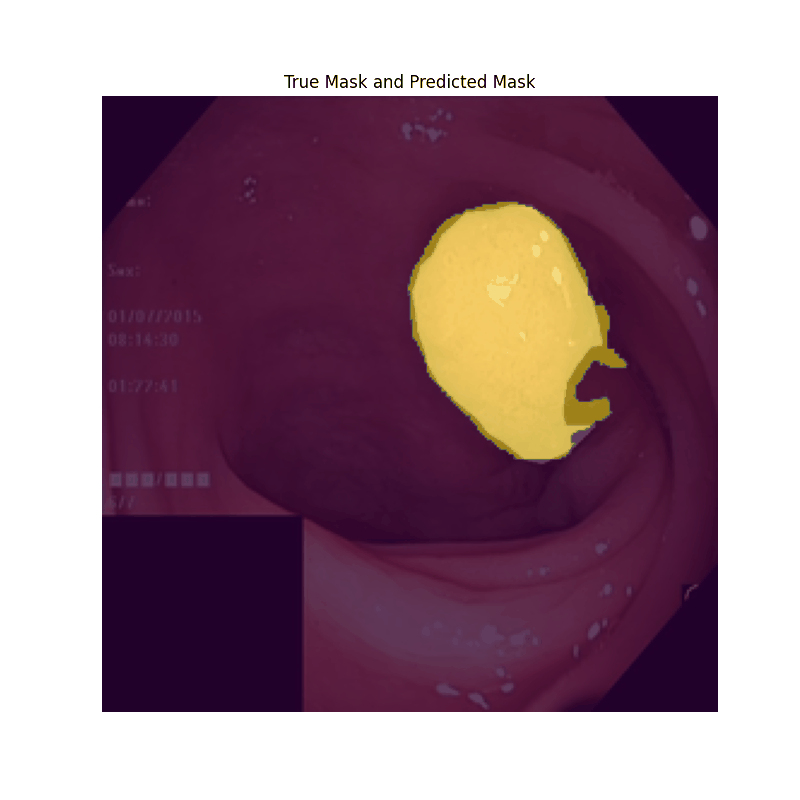

In [7]:
import imageio
import matplotlib.pyplot as plt
from IPython.display import Image


# Create and save a GIF of true masks and predicted masks overlaid
gif_images = []

for i in range(len(X_test)):
    fig, ax = plt.subplots(figsize=(8, 8))

    ax.imshow(X_test[i])
    
    # True Mask (overlay)
    ax.imshow(y_test[i], cmap='gray', alpha=0.5)
    ax.set_title('True Mask and Predicted Mask')
    ax.axis('off')

    # Predicted Mask (overlay)
    ax.imshow(unetpred[i], cmap='viridis', alpha=0.5)

    # Convert plot to image and append to gif_images list
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    gif_images.append(image)

    plt.close(fig)

# Save the GIF
gif_path = "results/unet.gif"
imageio.mimsave(gif_path, gif_images, fps=1)

# Display the GIF
Image(filename=gif_path)

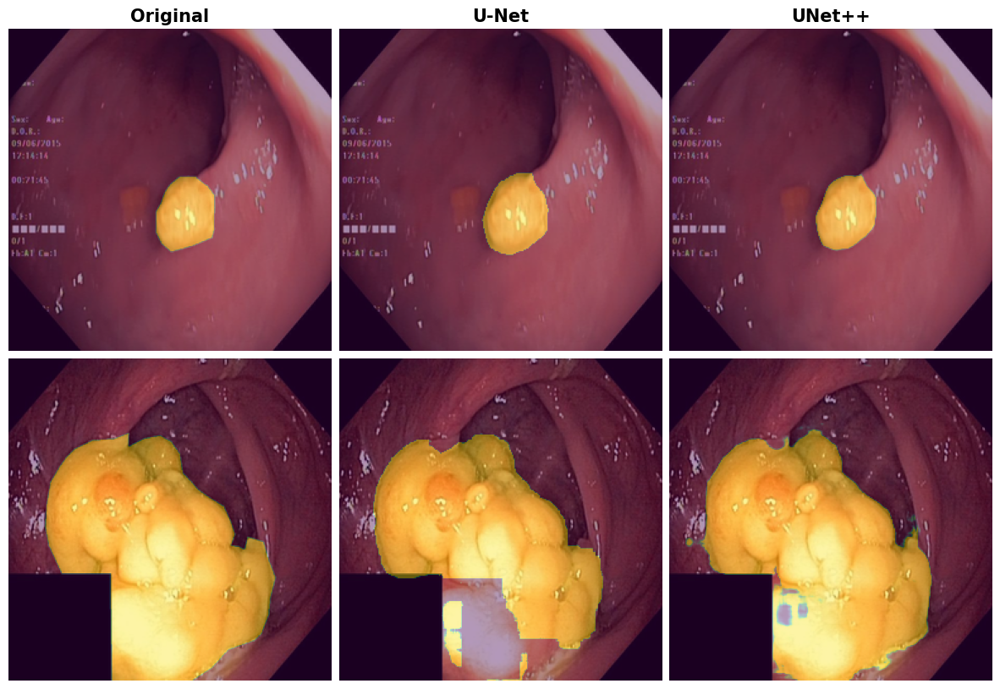

In [81]:
import matplotlib.pyplot as plt
import numpy as np

# Generate random indices
num_samples = 2
random_indices = np.array([32,9])

# Plot the random indexes for each prediction
fig, axes = plt.subplots(2, 3, figsize=(15, 15))

for i, idx in enumerate(random_indices):
    # Plot original image with original mask
    axes[i, 0].imshow(X_test[idx].squeeze())
    axes[i, 0].imshow(y_test[idx].squeeze(), cmap='viridis', alpha=0.4)
    if i == 0:
        axes[i, 0].set_title('Original', fontsize=15, fontweight='bold')
    axes[i, 0].axis('off')
    
    # Plot original image with UNet prediction
    axes[i, 1].imshow(X_test[idx].squeeze())
    axes[i, 1].imshow(unetpred[idx].squeeze(), cmap='viridis', alpha=0.4)
    if i == 0:
        axes[i, 1].set_title('U-Net', fontsize=15, fontweight='bold')
    axes[i, 1].axis('off')
    
    # Plot original image with Nested UNet prediction
    axes[i, 2].imshow(X_test[idx].squeeze())
    axes[i, 2].imshow(nestedpred[idx].squeeze(), cmap='viridis', alpha=0.4)
    if i == 0:
        axes[i, 2].set_title('UNet++', fontsize=15, fontweight='bold')
    axes[i, 2].axis('off')

plt.subplots_adjust(wspace=0.025, hspace=-0.49)

# Set the overall title for the subplots
# fig.suptitle('Predicted Masks Overlapping Original Images', fontsize=16)
fig.savefig('comparativeresults.png', dpi=300, bbox_inches='tight', pad_inches=0.1)
plt.show()

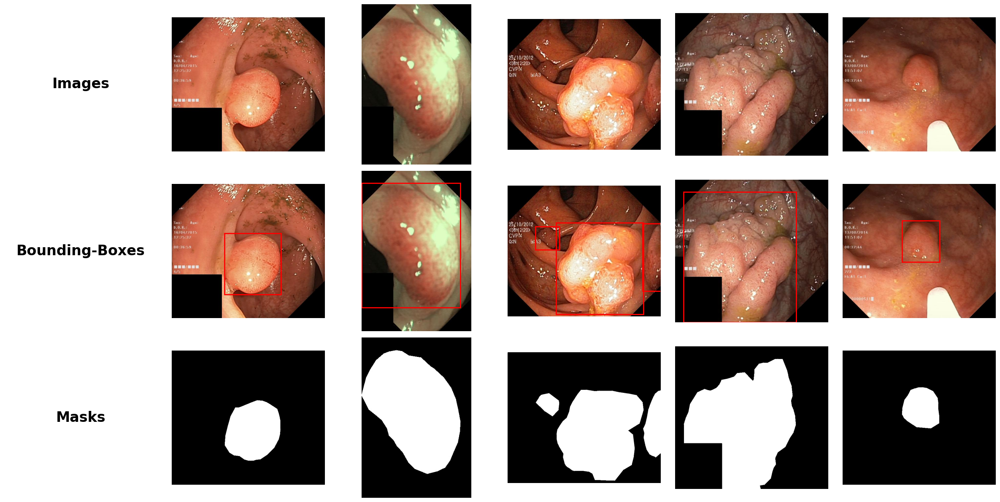

In [5]:
from PIL import Image
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import random


# Select 5 random images
random_images = random.sample(image_filenames, 5)

# Create a subplot with a grid view to display images, annotations, and masks
fig, axes = plt.subplots(3, 6, figsize=(24, 12))

# Define row names
row_names = ['Images', 'Bounding-Boxes', 'Masks']

# Plot row names
for i, name in enumerate(row_names):
    axes[i, 0].text(0.5, 0.5, name, ha='center', va='center', fontsize=24, weight='bold')
    axes[i, 0].axis('off')

# Plot the 5 random images with their corresponding bounding boxes and masks
for i, image_filename in enumerate(random_images):
    # Load the image
    image = Image.open(os.path.join(image_path, image_filename))

    # Display the image
    axes[0, i+1].imshow(image)
    axes[0, i+1].axis('off')

    # Extract bounding box annotations
    bbox_info = bounding_boxes.get(image_filename[:-4])  # Remove extension (.jpg) from image filename

    if bbox_info:
        # Process bounding box annotations
        for bbox in bbox_info['bbox']:
            xmin = bbox['xmin']
            ymin = bbox['ymin']
            xmax = bbox['xmax']
            ymax = bbox['ymax']

            # Create a rectangle patch
            rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')

            # Add the rectangle patch to the Axes
            axes[1, i+1].add_patch(rect)

    # Display the annotated image
    axes[1, i+1].imshow(image)
    axes[1, i+1].axis('off')

    # Load and display mask
    mask = masks.get(image_filename[:-4])
    if mask is not None:
        axes[2, i+1].imshow(mask, cmap='gray')
        axes[2, i+1].axis('off')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()